In [1]:
#%cd ../..

C:\Users\ManuJoseph\OneDrive - Thoucentric\Work\Projects\Playground\AdvancedTimeSeriesForecastingBook\Github\Modern-Time-Series-Forecasting-with-Python-


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import os
import plotly.io as pio
pio.templates.default = "plotly_white"
import pandas as pd
from pathlib import Path
from tqdm.autonotebook import tqdm
from IPython.display import display, HTML
# %load_ext autoreload
# %autoreload 2
np.random.seed()
tqdm.pandas()

#--------------ERRORS------------
#1. Missing packages - Solution: pip or conda install package_name

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_9537/600638824.py:9: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [2]:
os.makedirs("imgs", exist_ok=True)
preprocessed = Path("/Users/hellyshah/Documents/FUAS/Courses/HIS Project/Jupyter Notebooks/modern_timeseries/dataset/preprocessed")
assert preprocessed.is_dir(), "You have to run 02 - Preprocessing London Smart Meter Dataset.ipynb in Chapter02 before running this notebook"

#--------------ERRORS------------
#1. Set Path as per your setup

In [3]:
import sys
import os
sys.path.append(os.path.abspath('../../')) # added to get correct file tree to fetch src.utils
from src.utils import plotting_utils
#formating plot
def format_plot(fig, legends = None, xlabel="Time", ylabel="Value", figsize=(500,900), font_size=15, title_font_size=20):
    if legends:
        names = cycle(legends)
        fig.for_each_trace(lambda t:  t.update(name = next(names)))
    fig.update_layout(
            autosize=False,
            width=figsize[1],
            height=figsize[0],
            title={
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
            titlefont={
                "size": 20
            },
            legend_title = None,
            legend=dict(
                font=dict(size=font_size),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                title_text=ylabel,
                titlefont=dict(size=font_size),
                tickfont=dict(size=font_size),
            ),
            xaxis=dict(
                title_text=xlabel,
                titlefont=dict(size=font_size),
                tickfont=dict(size=font_size),
            )
        )
    return fig

#--------------ERRORS------------
#1. Missing src - Solution: Make sure you have downloaded the src folder from the Github repo mentioned and added the first 3 lines to adjust the file tree

# Reading Blocks 0-7

In [4]:
from src.utils.data_utils import compact_to_expanded #function written, which converts a form of our data frame as per requirements

In [16]:
#Reading preprocessed file from chapter 2
try:
    block_df = pd.read_parquet(preprocessed/"london_smart_meters_merged_block_0-7.parquet")
    display(block_df.head())
    print(block_df.shape[0]) # No of rows so it means we have 399 LCLid in blocks 0-7 because LCLid is the unique identifier
    print(len(block_df.LCLid.unique()))
except FileNotFoundError:
    display(HTML("""
    <div class="alert alert-block alert-warning">
    <b>Warning!</b> File not found. Please make sure you have run 02 - Preprocessing London Smart Meter Dataset.ipynb in Chapter02
    </div>
    """))

,LCLid,start_timestamp,frequency,energy_consumption,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,...,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
0,MAC000002,2012-10-13,30min,"[0.263, 0.2689999999999999, 0.275, 0.256, 0.21...",24144,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[186, 186, 188, 188, 190, 190, 203, 203, 206, ...","[8.78, 8.78, 8.27, 8.27, 7.87, 7.87, 7.89, 7.8...","[6.28, 6.28, 6.21, 6.21, 6.22, 6.22, 6.76, 6.7...","[1007.7, 1007.7, 1007.36, 1007.36, 1006.73, 10...","[7.55, 7.55, 7.34, 7.34, 6.75, 6.75, 6.89, 6.8...","[2.28, 2.28, 1.81, 1.81, 1.95, 1.95, 1.83, 1.8...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.84, 0.84, 0.87, 0.87, 0.89, 0.89, 0.93, 0.9...","[Clear, Clear, Clear, Clear, Partly Cloudy, Pa..."
1,MAC000246,2012-01-01,30min,"[0.509, 0.317, 0.253, 0.249, 0.93, 0.607, 0.10...",37872,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[229, 229, 238, 238, 229, 229, 231, 231, 227, ...","[12.12, 12.12, 12.59, 12.59, 12.45, 12.45, 12....","[10.97, 10.97, 11.02, 11.02, 11.04, 11.04, 10....","[1008.1, 1008.1, 1007.88, 1007.88, 1007.95, 10...","[12.12, 12.12, 12.59, 12.59, 12.45, 12.45, 12....","[5.9, 5.9, 6.06, 6.06, 5.31, 5.31, 4.68, 4.68,...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, clo...","[0.93, 0.93, 0.9, 0.9, 0.91, 0.91, 0.93, 0.93,...","[Mostly Cloudy, Mostly Cloudy, Overcast, Overc..."
2,MAC000450,2012-03-23,30min,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8...",33936,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[78, 78, 73, 73, 81, 81, 80, 80, 75, 75, 71, 7...","[8.76, 8.76, 8.54, 8.54, 8.09, 8.09, 7.34, 7.3...","[7.25, 7.25, 7.12, 7.12, 7.17, 7.17, 6.68, 6.6...","[1027.41, 1027.41, 1026.91, 1026.91, 1026.54, ...","[7.59, 7.59, 7.43, 7.43, 7.24, 7.24, 7.34, 7.3...","[2.18, 2.18, 2.07, 2.07, 1.72, 1.72, 1.34, 1.3...","[rain, rain, rain, rain, rain, rain, rain, rai...","[fog, fog, fog, fog, fog, fog, fog, fog, fog, ...","[0.9, 0.9, 0.91, 0.91, 0.94, 0.94, 0.96, 0.96,...","[Foggy, Foggy, Foggy, Foggy, Foggy, Foggy, Fog..."
3,MAC001074,2012-05-09,30min,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21...",31680,ToU,ACORN-,ACORN-,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[215, 215, 207, 207, 215, 215, 216, 216, 126, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[10.23, 10.23, 10.17, 10.17, 10.24, 10.24, 10....","[1007.39, 1007.39, 1007.21, 1007.21, 1007.06, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[2.35, 2.35, 2.15, 2.15, 1.84, 1.84, 1.22, 1.2...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, par...","[0.92, 0.92, 0.92, 0.92, 0.93, 0.93, 0.95, 0.9...","[Partly Cloudy, Partly Cloudy, Mostly Cloudy, ..."
4,MAC003223,2012-09-18,30min,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0...",25344,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[236, 236, 240, 240, 242, 242, 244, 244, 248, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[10.82, 10.82, 10.29, 10.29, 9.86, 9.86, 9.83,...","[1011.09, 1011.09, 1010.82, 1010.82, 1010.65, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[3.86, 3.86, 3.81, 3.81, 4.27, 4.27, 4.12, 4.1...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.81, 0.81, 0.83, 0.83, 0.84, 0.84, 0.86, 0.8...","[Clear, Clear, Clear, Clear, Clear, Clear, Par..."


399
399


Let's take all the consumers in one block for our exercise. Keep in mind, you can do the same with more number of blocks as long as it fits in your RAM

In [21]:
#Converting to expanded form
exp_block_df = compact_to_expanded(block_df[block_df.file=="block_7"], timeseries_col = 'energy_consumption',
static_cols = ["frequency", "series_length", "stdorToU", "Acorn", "Acorn_grouped", "file"],
time_varying_cols = ['holidays', 'visibility', 'windBearing', 'temperature', 'dewPoint',
       'pressure', 'apparentTemperature', 'windSpeed', 'precipType', 'icon',
       'humidity', 'summary'],
ts_identifier = "LCLid")
#above are the arguments of the function compact_to_expanded defined in src data_utils.py
exp_block_df.head()
exp_block_df.shape[0]

  0%|          | 0/50 [00:00<?, ?it/s]

1611792

In [23]:
# Taking a single time series from the block 
#This is how we can see a variation of energy consumption for one household over a period of time
ts_df = exp_block_df[exp_block_df.LCLid=="MAC000193"].set_index("timestamp")
ts_df.head()

,LCLid,energy_consumption,frequency,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,visibility,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
timestamp,,,,,,,,,,,,,,,,,,,,
2012-01-01 00:00:00,MAC000193,0.368,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.99,229,12.12,10.97,1008.10,12.12,5.90,rain,partly-cloudy-night,0.93,Mostly Cloudy
2012-01-01 00:30:00,MAC000193,0.386,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.99,229,12.12,10.97,1008.10,12.12,5.90,rain,partly-cloudy-night,0.93,Mostly Cloudy
2012-01-01 01:00:00,MAC000193,0.170,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.89,238,12.59,11.02,1007.88,12.59,6.06,rain,cloudy,0.90,Overcast
2012-01-01 01:30:00,MAC000193,0.021,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.89,238,12.59,11.02,1007.88,12.59,6.06,rain,cloudy,0.90,Overcast
2012-01-01 02:00:00,MAC000193,0.038,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,11.54,229,12.45,11.04,1007.95,12.45,5.31,rain,partly-cloudy-night,0.91,Mostly Cloudy


In [25]:

#adding some columns based on index (which is 'timestamp' here) for better understanding and analysis
ts_df["weekday_name"] = ts_df.index.day_name()
ts_df["weekday"] = ts_df.index.weekday
ts_df["week"] = ts_df.index.isocalendar().week
ts_df["day"] = ts_df.index.day
ts_df["hour"] = ts_df.index.hour
ts_df["date"] = ts_df.index.date
ts_df["month"] = ts_df.index.month
ts_df["month_name"] = ts_df.index.month_name()
ts_df["year"] = ts_df.index.year
ts_df.head()

,LCLid,energy_consumption,frequency,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,visibility,...,summary,weekday_name,weekday,week,day,hour,date,month,month_name,year
timestamp,,,,,,,,,,,,,,,,,,,,,
2012-01-01 00:00:00,MAC000193,0.368,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.99,...,Mostly Cloudy,Sunday,6,52,1,0,2012-01-01,1,January,2012
2012-01-01 00:30:00,MAC000193,0.386,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.99,...,Mostly Cloudy,Sunday,6,52,1,0,2012-01-01,1,January,2012
2012-01-01 01:00:00,MAC000193,0.170,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.89,...,Overcast,Sunday,6,52,1,1,2012-01-01,1,January,2012
2012-01-01 01:30:00,MAC000193,0.021,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,12.89,...,Overcast,Sunday,6,52,1,1,2012-01-01,1,January,2012
2012-01-01 02:00:00,MAC000193,0.038,30min,37872,ToU,ACORN-D,Affluent,block_7,NO_HOLIDAY,11.54,...,Mostly Cloudy,Sunday,6,52,1,2,2012-01-01,1,January,2012


In [27]:
#Making ordered categoricals to make for sorted plots
ts_df['month_name'] = pd.Categorical(ts_df['month_name'], categories=["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"], ordered=True)
ts_df['weekday_name'] = pd.Categorical(ts_df['weekday_name'], categories=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"], ordered=True)

In [28]:
#Interpolating Missing values
#Here seasonal interpolation is a class with one of the method fit_transform
#Let's try to understand linear interpolation
#2 points x1,y1 and x2,y2 and we know x as a timestamp here and want to know y
#for that compare slope y-y1/x-x1 = y2-y1/x2-x1

from src.imputation.interpolation import SeasonalInterpolation
#updates a column 'energy_consumption' with the column without missing values which is filled by interposlation
ts_df['energy_consumption'] = SeasonalInterpolation(seasonal_period=48*7).fit_transform(ts_df.energy_consumption.values.reshape(-1,1))

# Line Charts

## Basic Line Plot

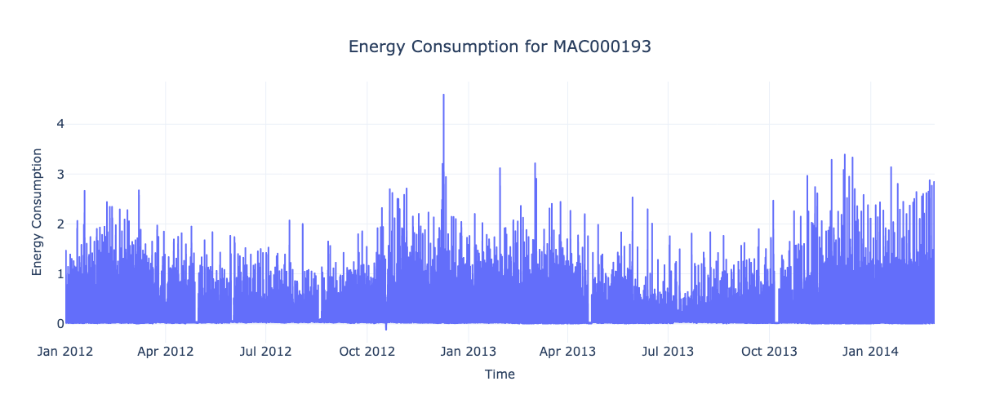

In [11]:
fig = px.line(ts_df, y="energy_consumption", title="Energy Consumption for MAC000193")
fig = format_plot(fig, ylabel="Energy Consumption")
fig.write_image("imgs/line_plot.png")
fig.show()

### Rolling Average Plot

In [32]:
ts_df["rolling_monthly_avg"] = ts_df["energy_consumption"].rolling(window=48*30).mean() #creating rolling window for month 
#as we have 48 readings each day (for halfhourly gaps) * 30

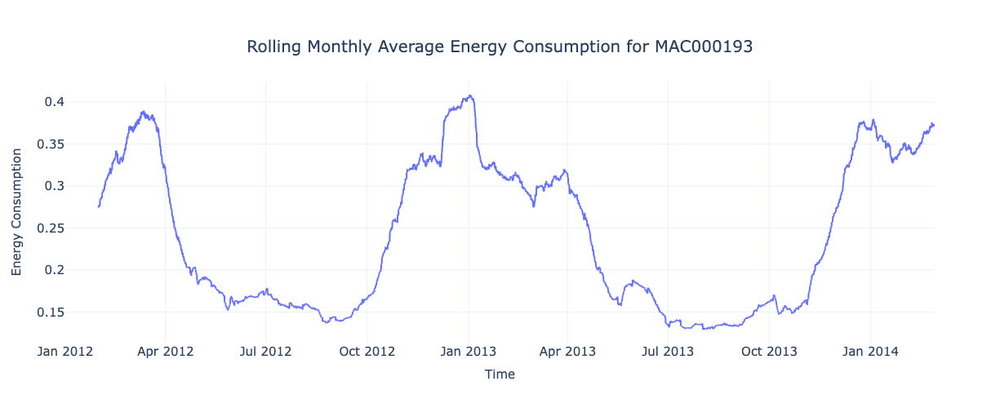

In [34]:
fig = px.line(ts_df, y="rolling_monthly_avg", title="Rolling Monthly Average Energy Consumption for MAC000193") #px alias of plotly express
fig = format_plot(fig, ylabel="Energy Consumption") #function what we defined
fig.write_image("imgs/rolling_avg_line_plot.png")
fig.show()
#When you have a long time series with high variation, as we have, the line plot can get a bit chaotic. 
#One of the options to get a macroview of the time series in terms of trends and movement is to plot a smoothed version of the time series. 

## Multivariate Line Chart

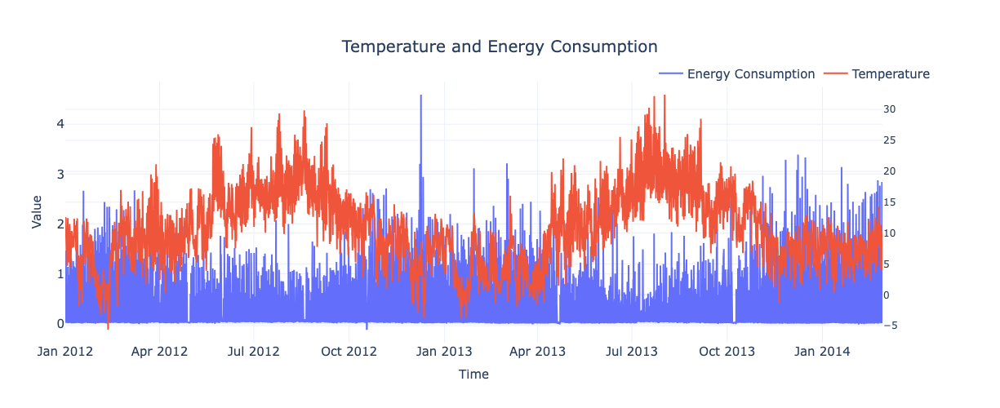

In [36]:
#multivariate line plots with 2 variables Energy "Consumption", "Temperature"

fig = plotting_utils.two_line_plot_secondary_axis(x=ts_df.index, 
                                   y1=ts_df.energy_consumption, 
                                   y2=ts_df.temperature, 
                                   y1_name="Energy Consumption", 
                                   y2_name="Temperature", 
                                   title="Temperature and Energy Consumption", 
                                   # greyscale=True,
                                  dash_secondary=False)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/temp_vs_energy.png")
fig.show()
#Here, we can see a negative correlation in yearly resolution

### Multivariate Line Chart - Hourly Resolution

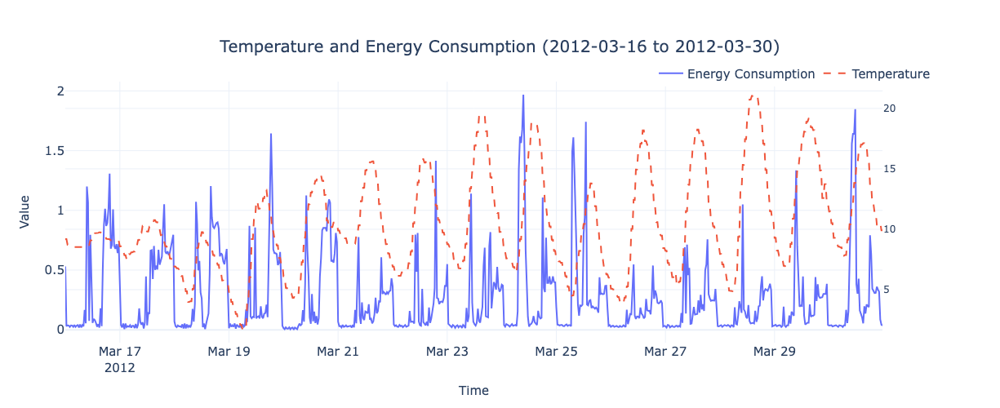

In [37]:
zoom_window = slice("2012-03-16", "2012-03-30")
fig = plotting_utils.two_line_plot_secondary_axis(x=ts_df[zoom_window].index, 
                                   y1=ts_df[zoom_window].energy_consumption, 
                                   y2=ts_df[zoom_window].temperature, 
                                   y1_name="Energy Consumption", 
                                   y2_name="Temperature", 
                                   title="Temperature and Energy Consumption (2012-03-16 to 2012-03-30)",
                                   greyscale=False,
                                   dash_secondary=True)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/temp_vs_energy_zoomed.png")
fig.show()


### Multivariate Line Chart - Monthly Resolution

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_9537/3330605001.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



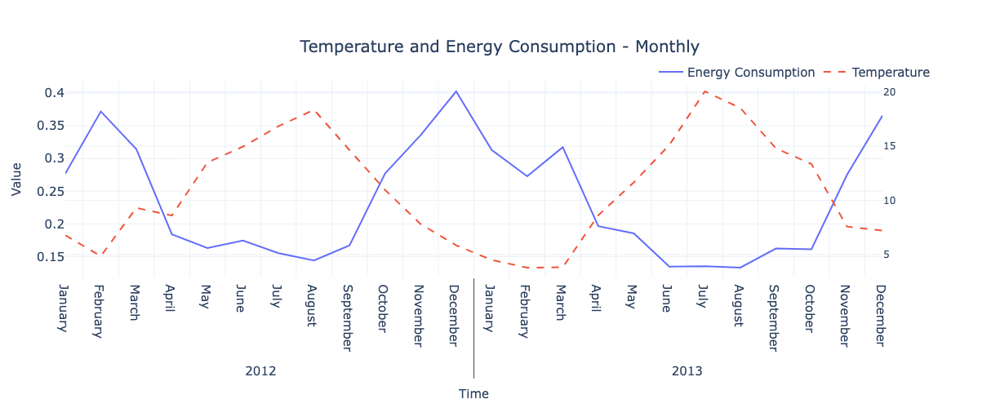

In [40]:
# Average energy_consumption and temperature for each month
plot_df = ts_df[~ts_df.year.isin([2011, 2014])].groupby(["year", "month_name"])[['energy_consumption', "temperature"]].mean().reset_index()
#mean taken for monthly energy consumption
plot_df['year_month'] = plot_df["year"].astype(str) +" "+ plot_df['month_name'].astype(str).str.zfill(2)
fig = plotting_utils.two_line_plot_secondary_axis(x=[plot_df.year, plot_df.month_name], y1=plot_df.energy_consumption, y2=plot_df.temperature, y1_name="Energy Consumption", y2_name="Temperature", title="Temperature and Energy Consumption - Monthly", dash_secondary=True)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/temp_vs_energy_monthly.png")
fig.show()

# Seasonal Plots

## Annual Seasonality at Monthly Resolution

In [18]:
#Montlhly Average energy consumption
plot_df = ts_df[~ts_df.year.isin([2011, 2014])].groupby(["year", "month_name"])[['energy_consumption',"temperature"]].mean().reset_index()

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_8262/1505463684.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



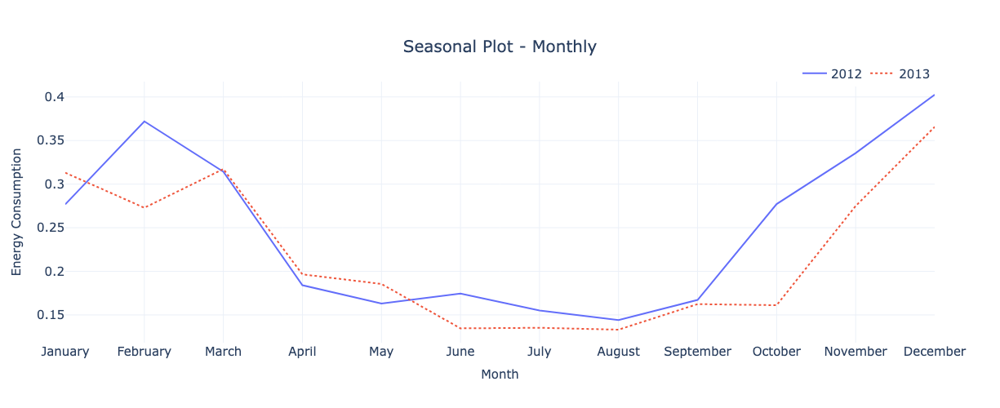

In [41]:
fig = px.line(plot_df, x="month_name", y='energy_consumption', color="year", line_dash="year", title="Seasonal Plot - Monthly")
#For seasonality setting Month_name for the x-axis, what we have set earlier
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Month")
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/seasonal_plot_monthly.png")
fig.show()
#For both the years 2012 and 2013, overall seasonality seems similar, but there are some deviations as well for example, in Feb and Oct, but maybe that can be explained by another variable

/Users/hellyshah/Documents/FUAS/Courses/HIS Project/Jupyter Notebooks/modern_timeseries/src/utils/plotting_utils.py:63: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



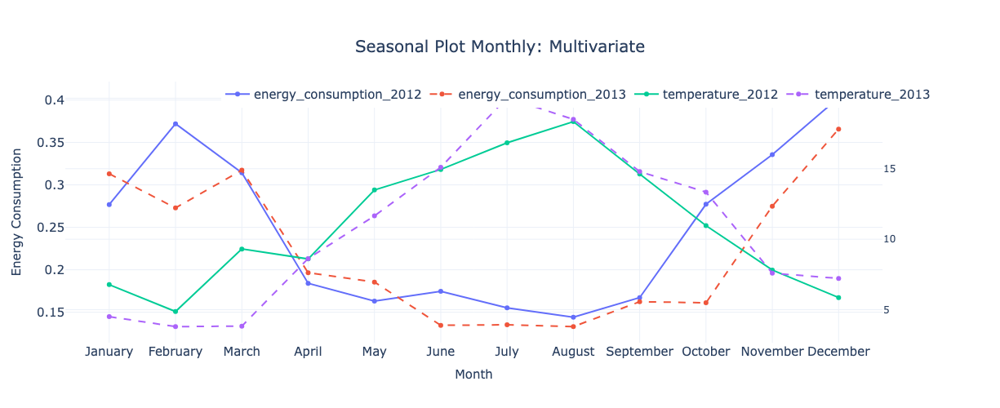

In [42]:
fig = plotting_utils.multiple_line_plot_secondary_axis(plot_df, 
                                        x="month_name", 
                                        primary='energy_consumption', 
                                        secondary='temperature', 
                                        color_or_linetype="year", 
                                        title="Seasonal Plot Monthly: Multivariate",
                                       use_linetype=True,
                                       greyscale=False)
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Month")
fig.update_layout(legend=dict(
                orientation="h",
                yanchor="bottom",
                y=0.9,
                xanchor="right",
                x=1,
            ))
fig.write_image("imgs/seasonal_plot_monthly_mv.png")
fig.show()
#the temperature stayed warmer for 1 month more, hence why the energy consumption pattern was slightly different from last year.

## Daily Seasonality at Hourly Resolution

In [44]:
#Calculating the day-hour average
plot_df = ts_df.groupby(["day", "hour"])['energy_consumption'].mean().reset_index()

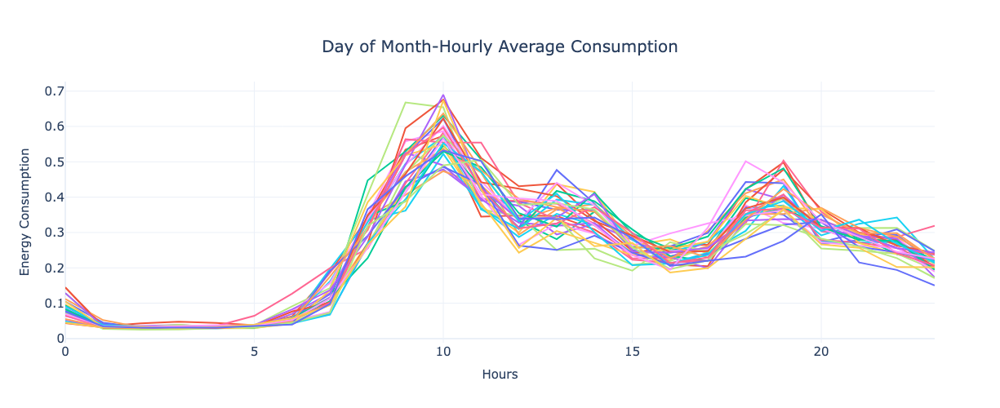

In [45]:
fig = px.line(plot_df[["energy_consumption", "hour", "day"]], y="energy_consumption", x="hour",color="day", title="Day of Month-Hourly Average Consumption")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None)
fig.update_layout(showlegend=False) 
# plotting_utils.make_lines_greyscale(fig)
fig.write_image("imgs/seasonal_plot_hourly.png")
fig.show()
#Comparison between 30 days spaned over 24 hours

# Seasonal Box Plots

In [23]:
plot_df =  ts_df.groupby(["date","weekday_name", "hour"])["energy_consumption"].mean().reset_index().dropna()

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_8262/3628635336.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



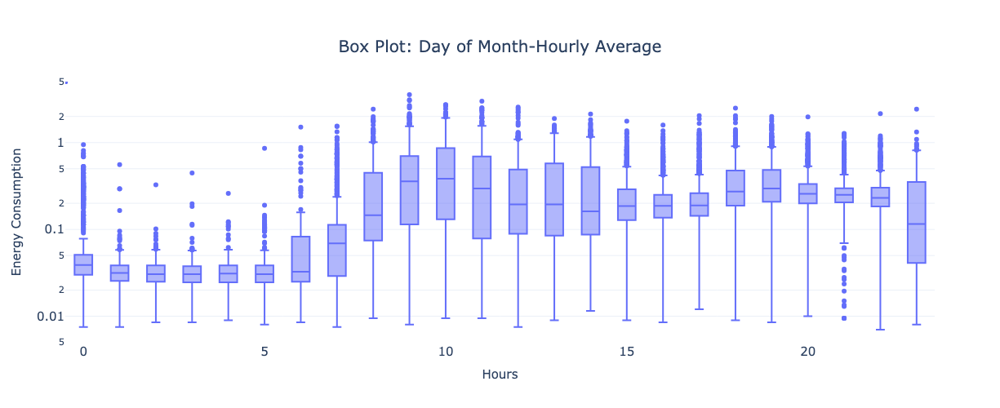

In [24]:
fig = px.box(plot_df, y="energy_consumption", x="hour", log_y=True, title="Box Plot: Day of Month-Hourly Average")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None)
fig.write_image("imgs/box_plot_hourly_avg.png")
fig.show()
#we have here 24 box plots
#horizontal line gives a median of each day over the time period
#Box is Interquartile range (IQR)
#Small horizontal lines both sides are min and max and points beyond that are outliers

#Here, we can see that spread of data(variablity) is higher from 9 and peek is also at 10 AM

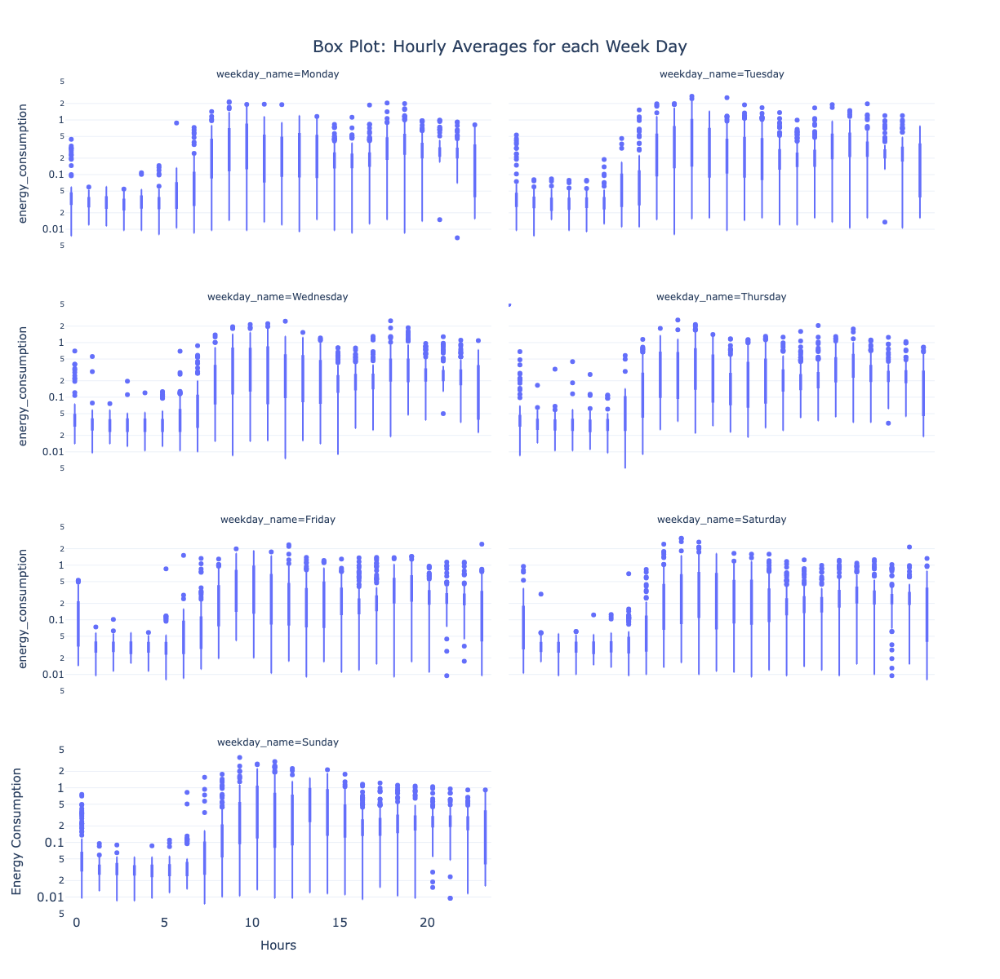

In [25]:
fig = px.box(plot_df, y="energy_consumption", x="hour", facet_col="weekday_name", facet_col_wrap=2, log_y=True, category_orders={"weekday_name":ts_df.weekday_name.cat.categories.tolist()}, title="Box Plot: Hourly Averages for each Week Day")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None, figsize=(1200, 1500))
fig.write_image("imgs/box_plot_hourly_weekday.png")
fig.show()

# Calendar Heatmap

In [50]:
plot_df = pd.pivot_table(ts_df, index="weekday_name", values='energy_consumption', columns="hour", aggfunc="mean") 
#creating pivot table for index(row) of each weekday and avg over hours for a particular weekday
# plot_df.index = "Day "+ plot_df.index.astype(str)
#Heatamp lets you analyse in 2D

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_9537/3683328306.py:1: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



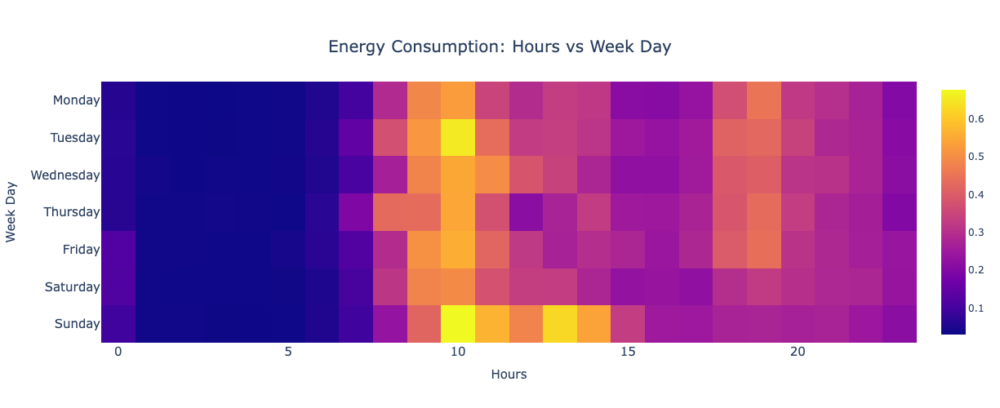

In [51]:
fig = px.imshow(plot_df, height=600, title="Energy Consumption: Hours vs Week Day")
fig = format_plot(fig, ylabel="Week Day", xlabel="Hours", legends=None)
fig.write_image("imgs/hour_weekday_heatmap.png")
fig.show()

#Monday to Saturday have similar peaks – that is, once in the morning and once in the evening.
#However, Sunday has a slightly different pattern, with higher consumption throughout the day.

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_9537/1974294615.py:1: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



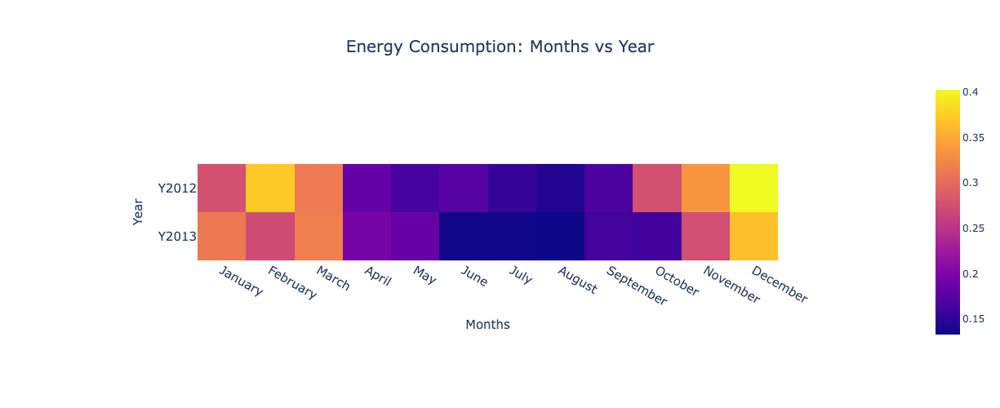

{'MAC000193'}

In [59]:
plot_df = pd.pivot_table(ts_df[~ts_df.year.isin([2011, 2014])], index="year", values='energy_consumption', columns="month_name", aggfunc="mean")
#creating pivot table for index(row) of each year and average over a month for a particular year
plot_df.index = "Y"+ plot_df.index.astype(str)
fig = px.imshow(plot_df, height=600, title="Energy Consumption: Months vs Year")
fig = format_plot(fig, ylabel="Year", xlabel="Months", legends=None)
fig.write_image("imgs/month_year_heatmap.png")
fig.show()
#JUST a reminder again that we are seeing everything for just one particular household MAC000193
set(ts_df['LCLid'])

/var/folders/fj/r6wgbnzj0h11qb_f4_10p_rw0000gn/T/ipykernel_9537/807137164.py:1: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



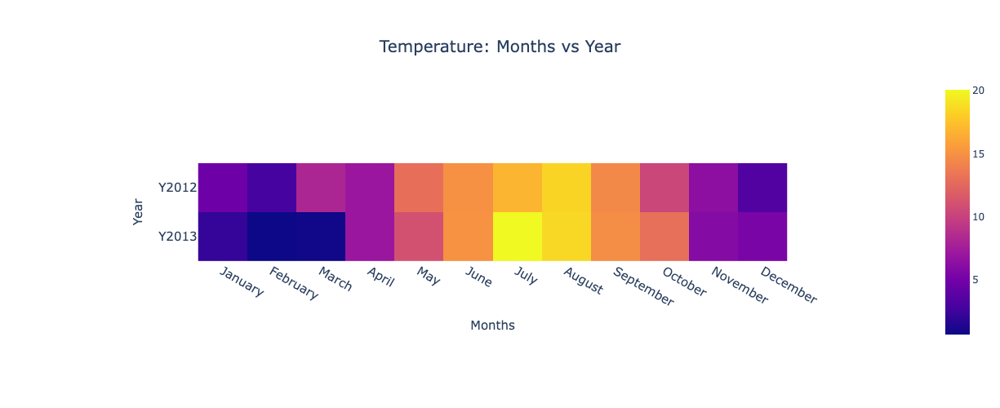

In [60]:
plot_df = pd.pivot_table(ts_df[~ts_df.year.isin([2011, 2014])], index="year", values='apparentTemperature', columns="month_name", aggfunc="mean")
plot_df.index = "Y"+ plot_df.index.astype(str)

fig = px.imshow(plot_df, height=600, title="Temperature: Months vs Year")
fig = format_plot(fig, ylabel="Year", xlabel="Months", legends=None)
fig.write_image("imgs/month_year_heatmap_temperature.png")
fig.show()

#We can see -ve correlation for temp and energy consumption

# Autocorrelation Plots

In [66]:
#autocorrelation is the correlation between the values of a time series in successive periods. 
#Most time series have a heavy dependence on the value in the previous period, and this is a critical component in a lot of the forecasting models 
from src.decomposition.seasonal import MultiSeasonalDecomposition, STL
stl = MultiSeasonalDecomposition(seasonal_model="fourier",seasonality_periods=["day_of_year", "day_of_week", "hour"], model = "additive", n_fourier_terms=10)
res = stl.fit(ts_df.energy_consumption)

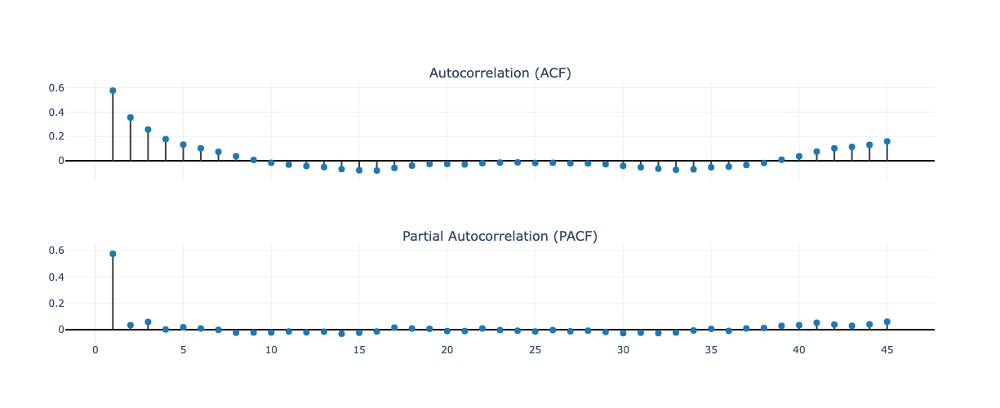

In [67]:
fig = plotting_utils.plot_autocorrelation(res.resid, vertical=True)
#This function does not take x label and y label will modify that later
fig.write_image("imgs/acf_pacf.png")
fig.show()
#t is highly correlated to t-1 and influence drops with increasing lags
#One thing we need to keep in mind is that the autocorrelation and partial autocorrelation analysis works best if the time series is stationary
#a quick and dirty way of making a series stationary is to use seasonal decomposition and just pick the residuals